# Install detectron2

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15554, done.
remote: Counting objects: 100% (279/279), done.
remote: Compressing objects: 100% (214/214), done.
remote: Total 15554 (delta 95), reused 208 (delta 65), pack-reused 15275
Receiving objects: 100% (15554/15554), 6.42 MiB | 7.34 MiB/s, done.
Resolving deltas: 100% (11209/11209), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.1 MB/s eta 0:00:0

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Unzip Image foldar

In [ ]:
# prompt: unzip file

!unzip -j /content/HW4_images.zip -d /content/Images


Archive:  /content/HW4_images.zip
  inflating: /content/Images/Backlit faces1.jpg  
  inflating: /content/Images/Backlit faces2.jpg  
  inflating: /content/Images/Blurry faces1.jpg  
  inflating: /content/Images/Blurry faces2.jpg  
  inflating: /content/Images/Candid photography1.jpg  
  inflating: /content/Images/Candid photography2.jpg  
  inflating: /content/Images/Close-up faces1.jpg  
  inflating: /content/Images/Close-up faces2.jpg  
  inflating: /content/Images/Diverse demographics faces1.jpg  
  inflating: /content/Images/Diverse demographics faces2.jpg  
  inflating: /content/Images/Facial expressions1.jpg  
  inflating: /content/Images/Facial expressions2.jpg  
  inflating: /content/Images/Group portraits1.jpg  
  inflating: /content/Images/Group portraits2.jpg  
  inflating: /content/Images/Low light faces1.jpg  
  inflating: /content/Images/Low light faces2.jpg  
  inflating: /content/Images/Occluded faces1.png  
  inflating: /content/Images/Occluded faces2.jpg  
  inflatin

# Run a pre-trained mask_rcnn_R_50_FPN_3x

[04/25 02:32:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
Processing image: /content/Images/Low light faces1.jpg


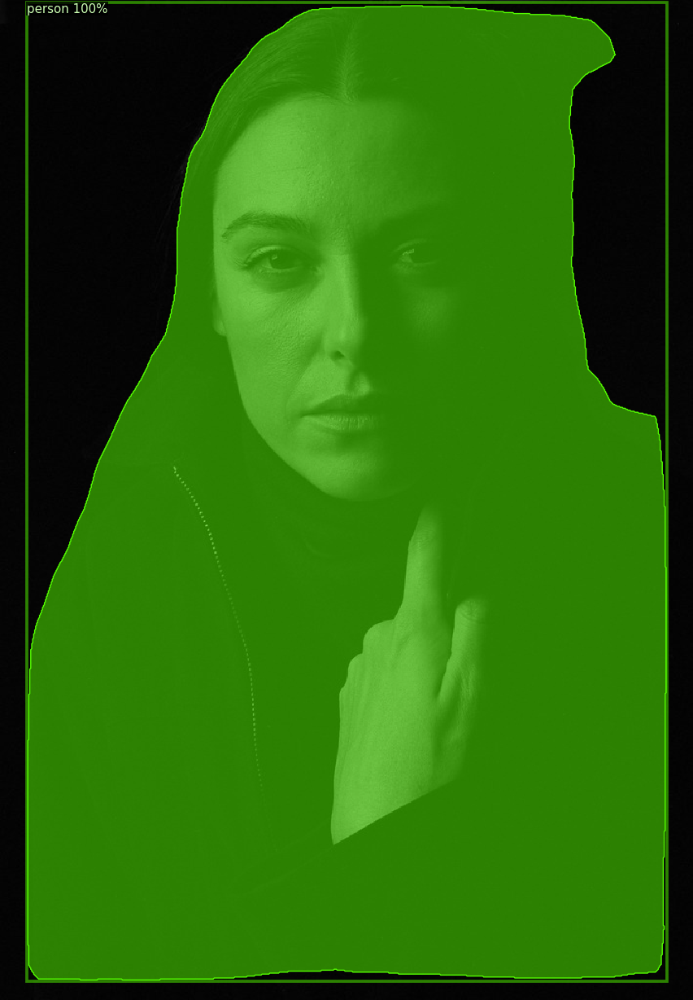


Processing image: /content/Images/Facial expressions2.jpg


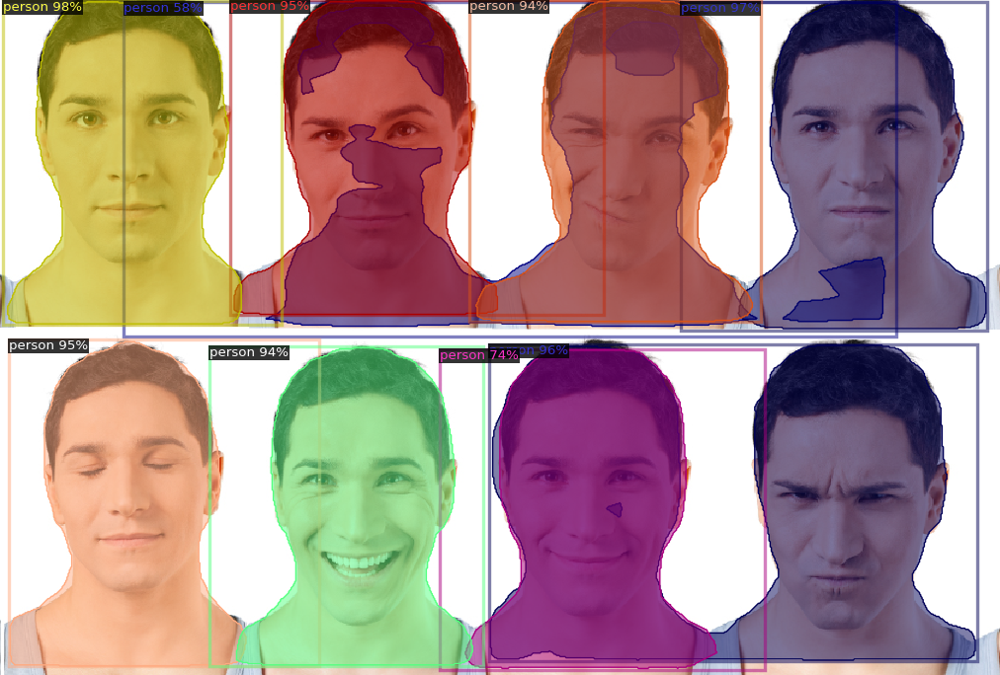


Processing image: /content/Images/Diverse demographics faces2.jpg


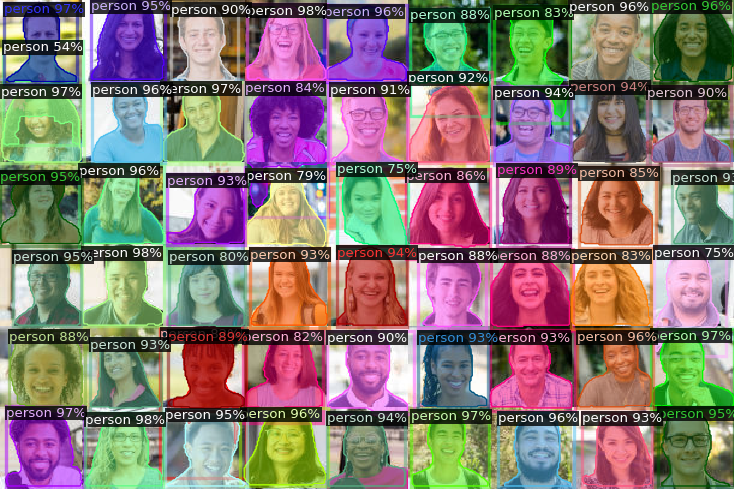


Processing image: /content/Images/Portrait photography2.jpg


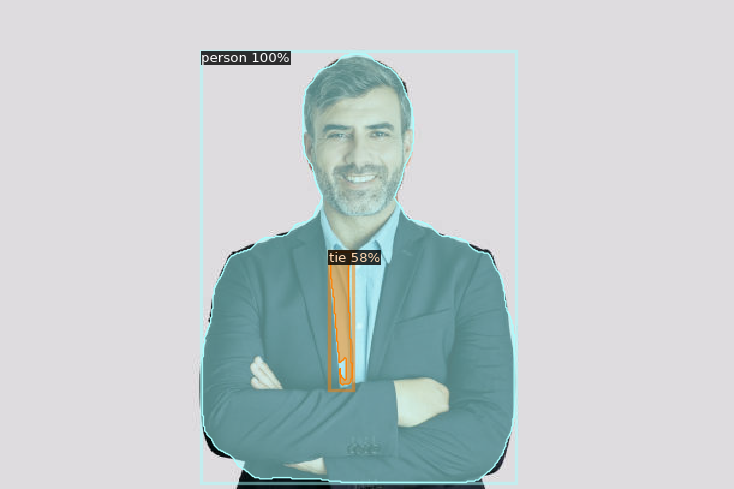


Processing image: /content/Images/Close-up faces2.jpg


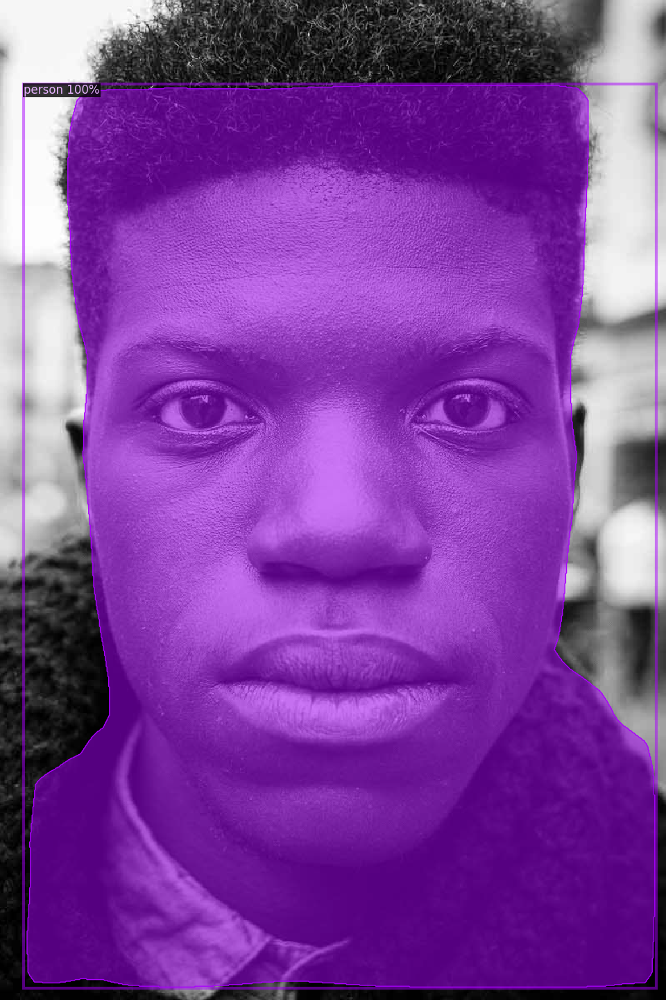


Processing image: /content/Images/Close-up faces1.jpg


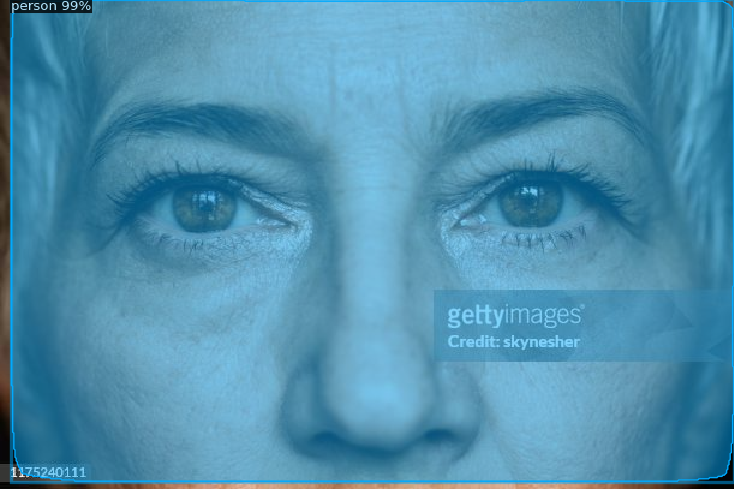


Processing image: /content/Images/Group portraits2.jpg


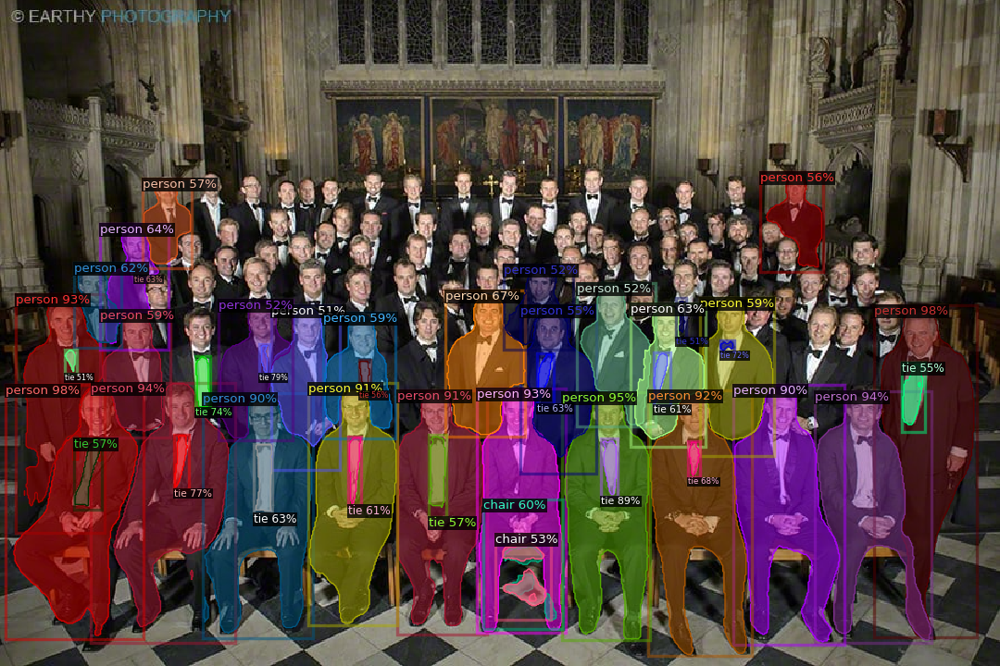


Processing image: /content/Images/Low light faces2.jpg


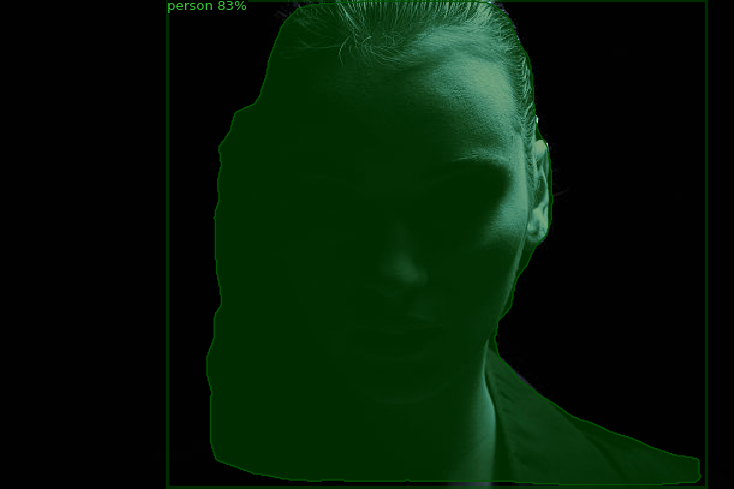


Processing image: /content/Images/Facial expressions1.jpg


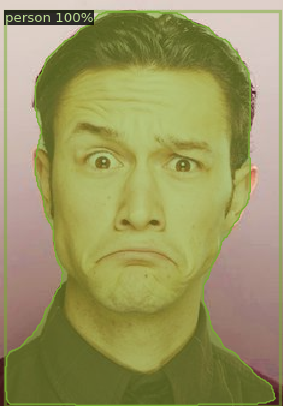


Processing image: /content/Images/Backlit faces1.jpg


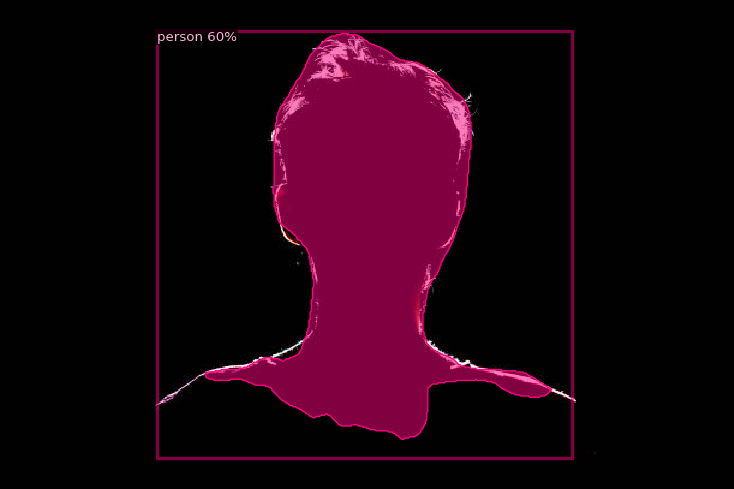


Processing image: /content/Images/Portrait photography1.jpg


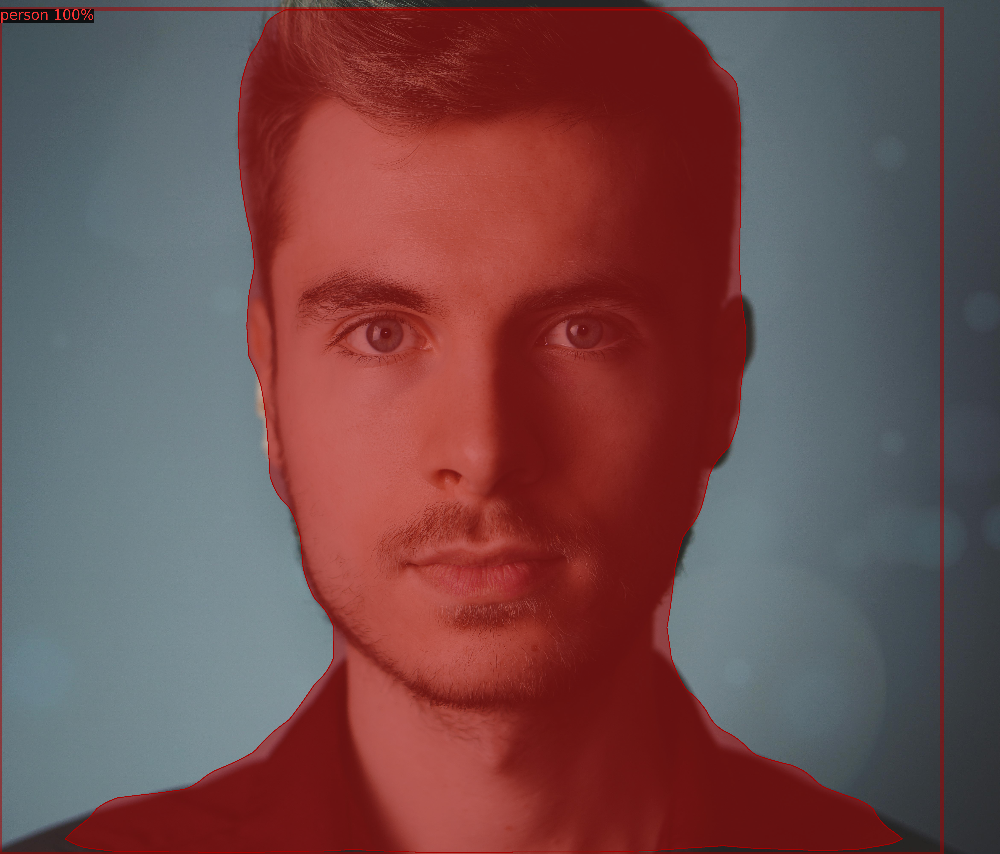


Processing image: /content/Images/Candid photography1.jpg


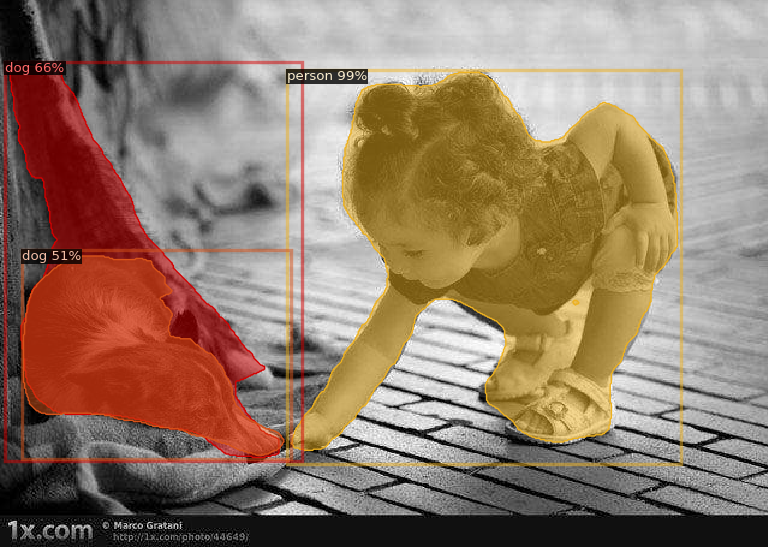


Processing image: /content/Images/Blurry faces2.jpg


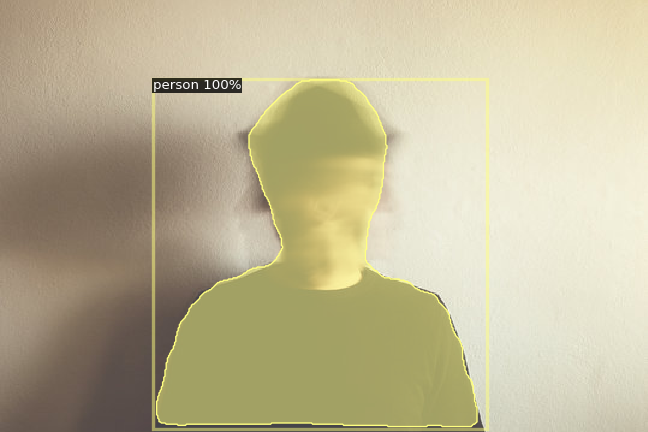


Processing image: /content/Images/Blurry faces1.jpg


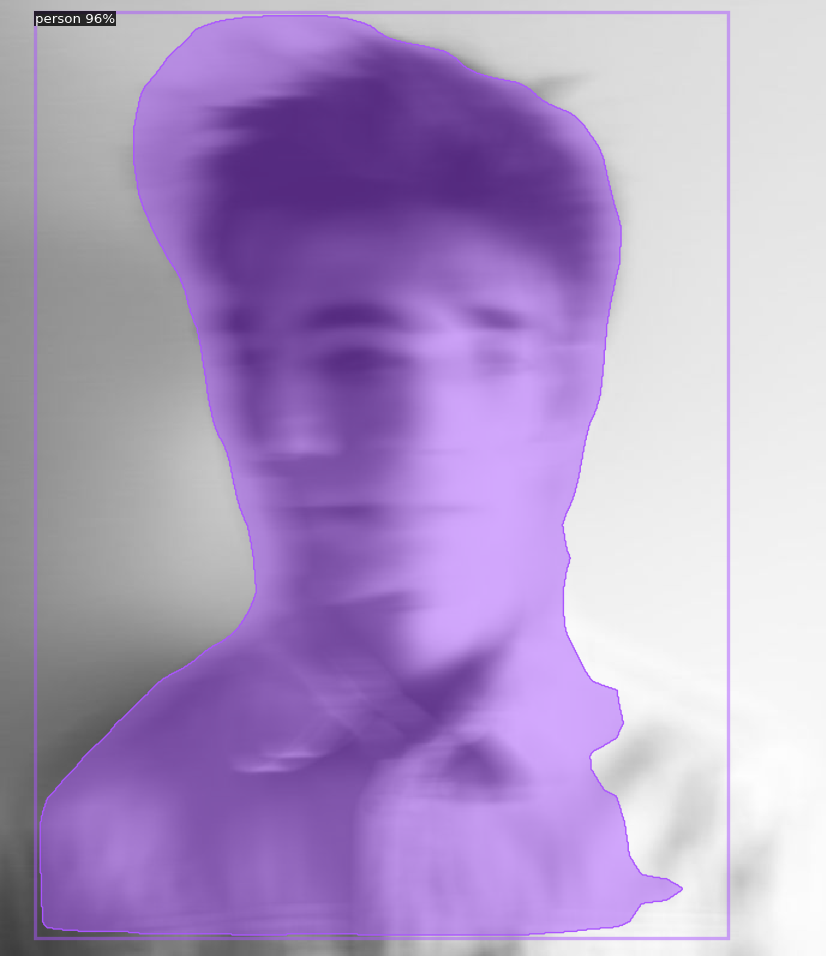


Processing image: /content/Images/Occluded faces2.jpg


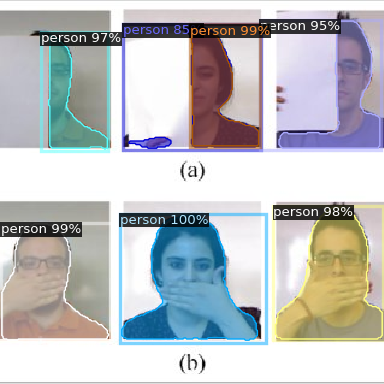


Processing image: /content/Images/Diverse demographics faces1.jpg


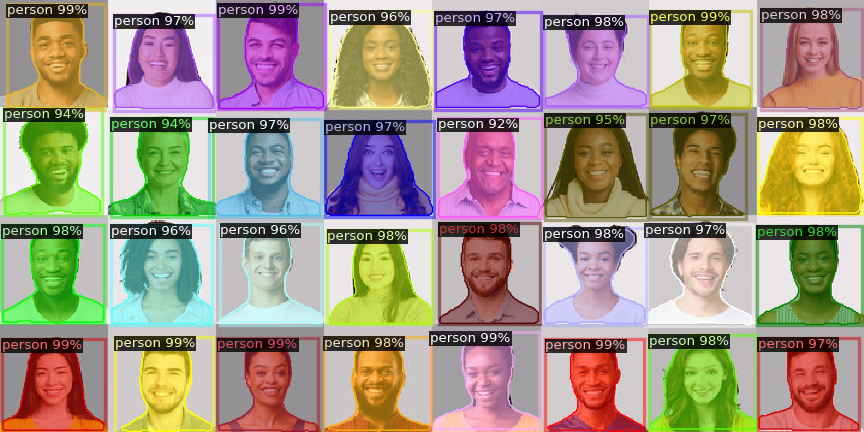


Processing image: /content/Images/Group portraits1.jpg


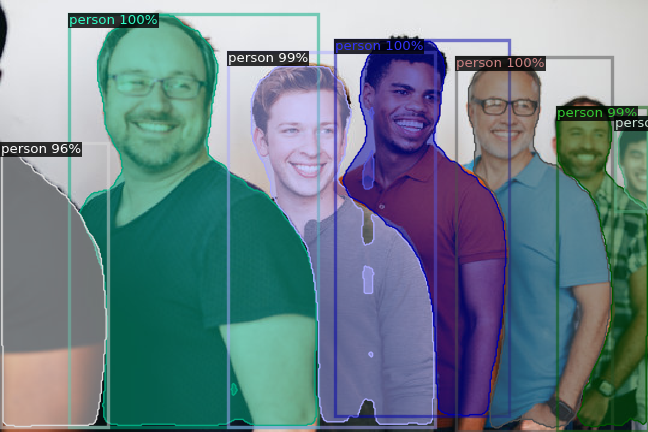


Processing image: /content/Images/Occluded faces1.png


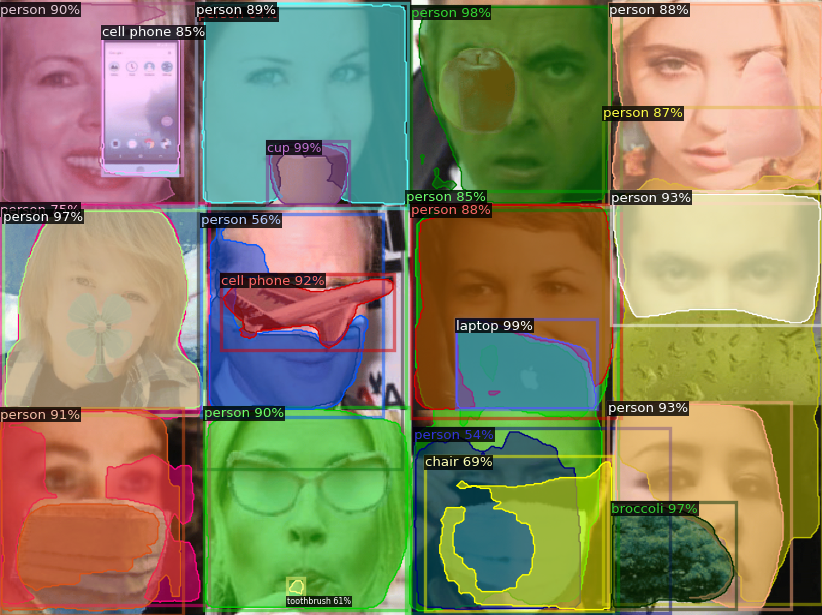


Processing image: /content/Images/Backlit faces2.jpg


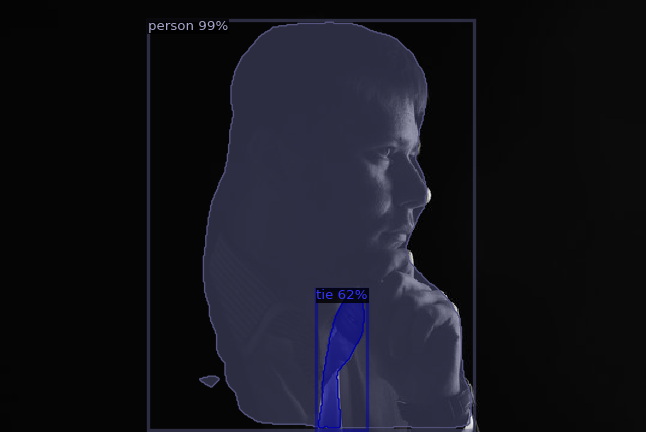


Processing image: /content/Images/Candid photography2.jpg


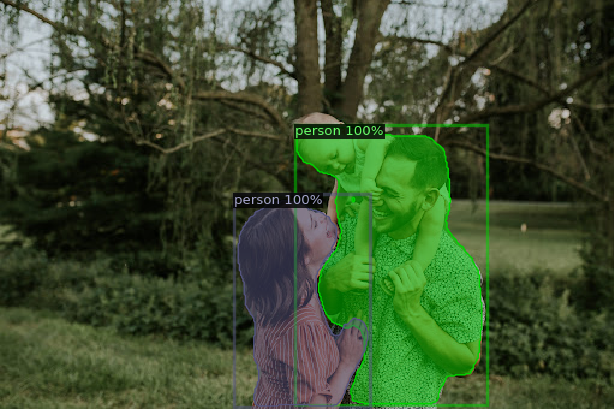

In [ ]:
from google.colab.patches import cv2_imshow

# Function to perform instance segmentation on a single image
def perform_instance_segmentation(image_path, predictor):
    im = cv2.imread(image_path)
    outputs = predictor(im)

    # Visualize the predictions
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    result_image = out.get_image()[:, :, ::-1]
    cv2_imshow(result_image)  # Display the result using cv2_imshow instead
    return result_image

# Configuration for the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# Create a predictor
predictor = DefaultPredictor(cfg)

# Path to the folder containing images
folder_path = "/content/Images"

# Iterate over images in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Consider only image files
        image_path = os.path.join(folder_path, filename)
        print(f"Processing image: {image_path}")
        perform_instance_segmentation(image_path, predictor)
        print()


# Run a pre-trained mask_rcnn_R_101_FPN_3x

[04/25 02:35:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl ...


model_final_a3ec72.pkl: 254MB [00:01, 219MB/s]                           


Processing image: /content/Images/Low light faces1.jpg


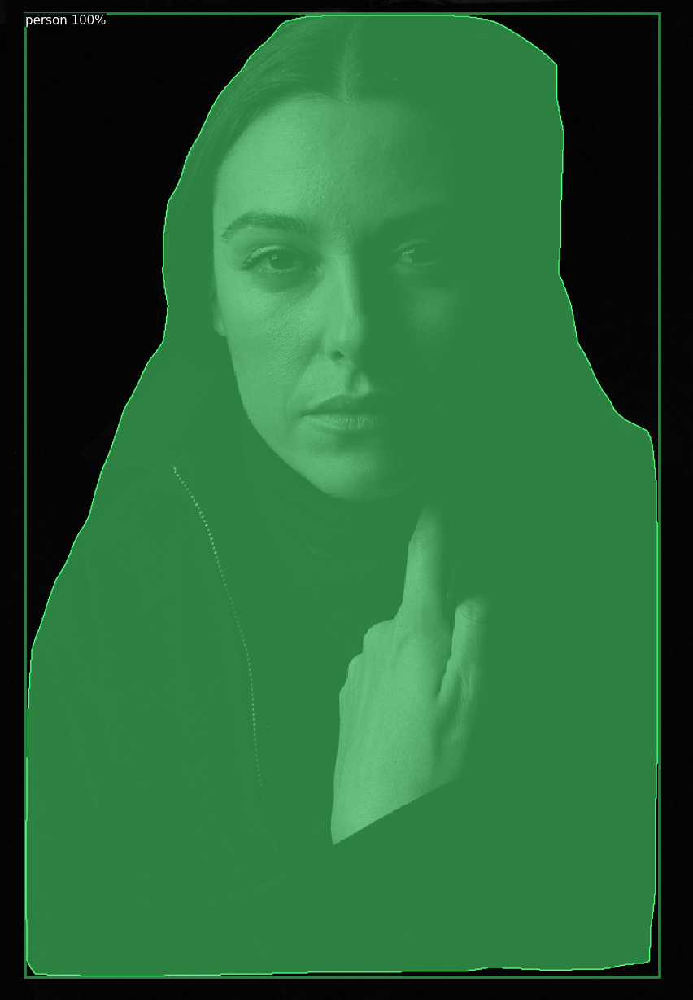


Processing image: /content/Images/Facial expressions2.jpg


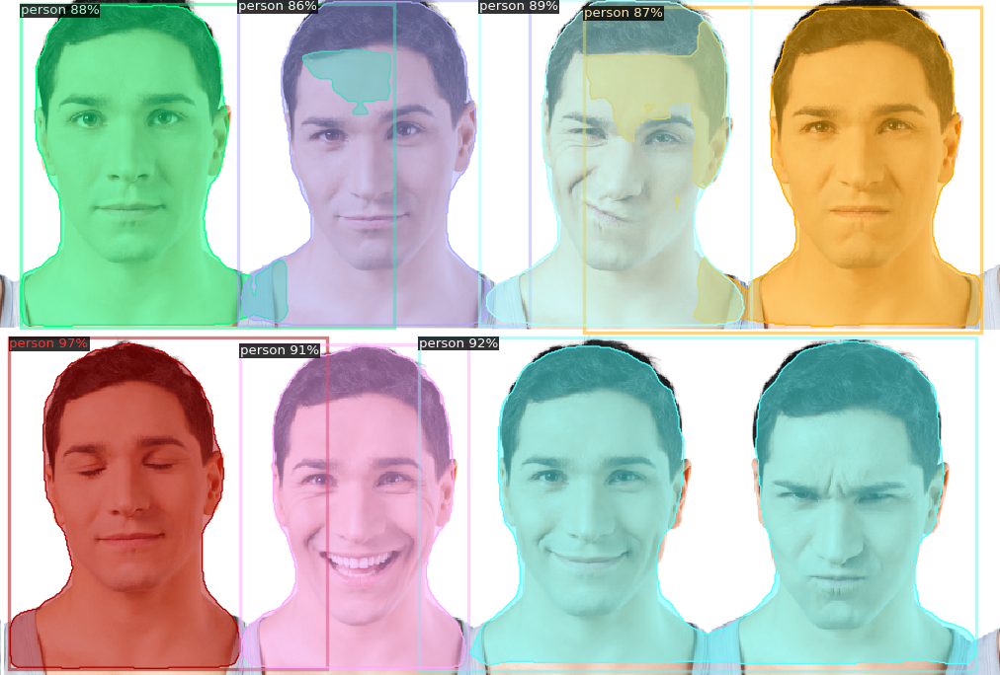


Processing image: /content/Images/Diverse demographics faces2.jpg


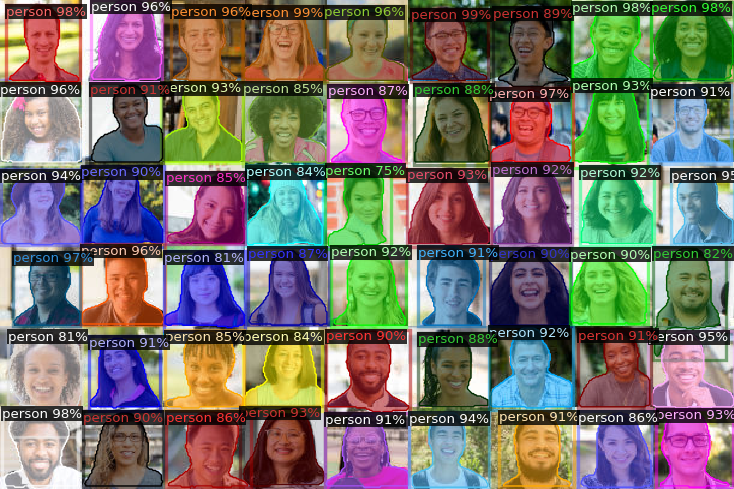


Processing image: /content/Images/Portrait photography2.jpg


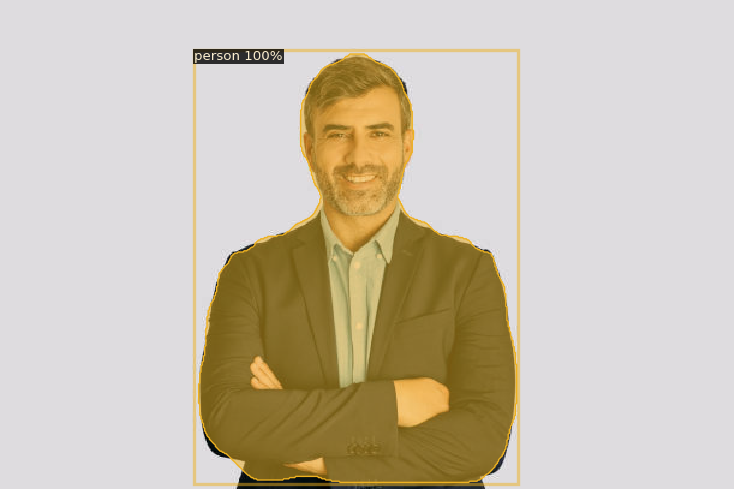


Processing image: /content/Images/Close-up faces2.jpg


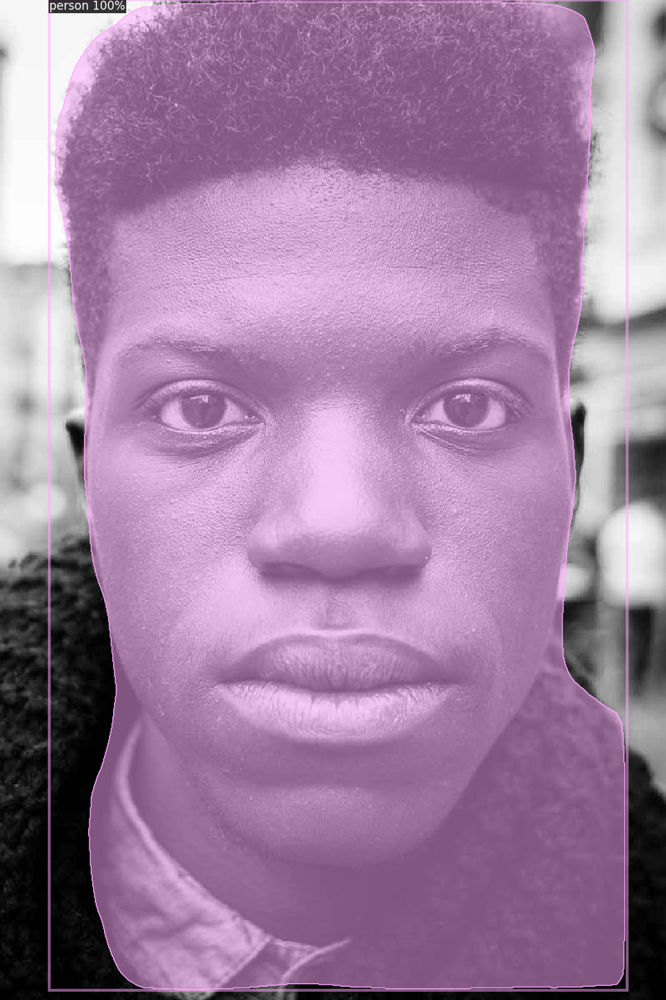


Processing image: /content/Images/Close-up faces1.jpg


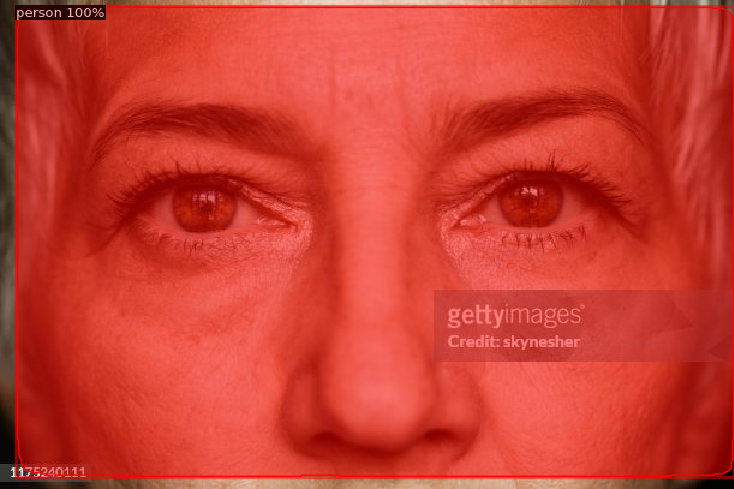


Processing image: /content/Images/Group portraits2.jpg


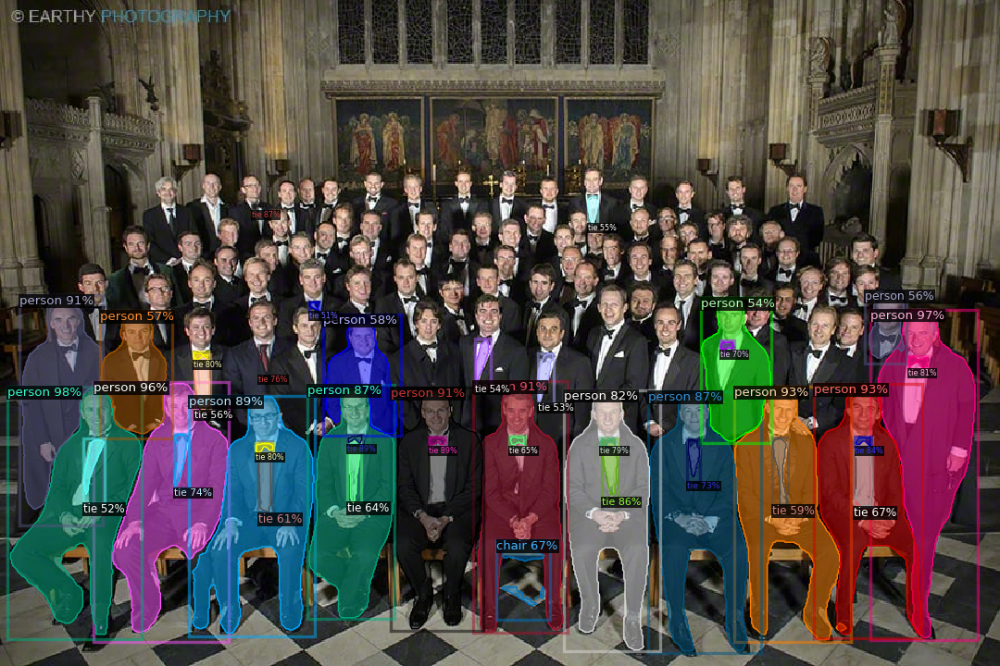


Processing image: /content/Images/Low light faces2.jpg


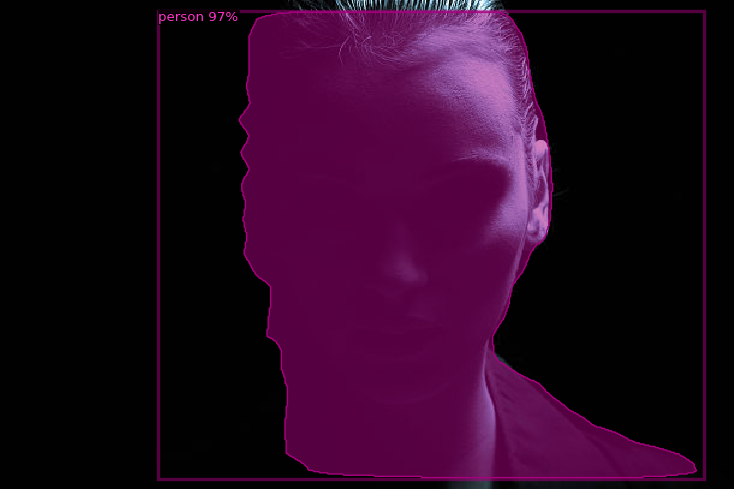


Processing image: /content/Images/Facial expressions1.jpg


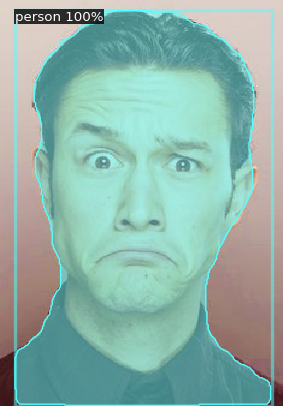


Processing image: /content/Images/Backlit faces1.jpg


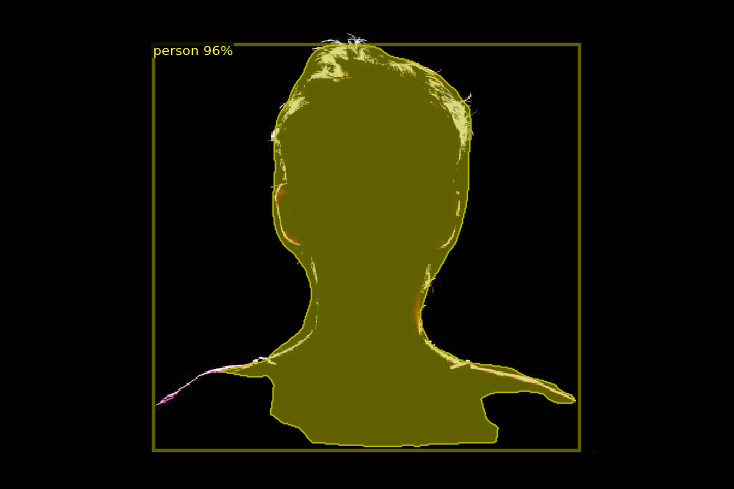


Processing image: /content/Images/Portrait photography1.jpg


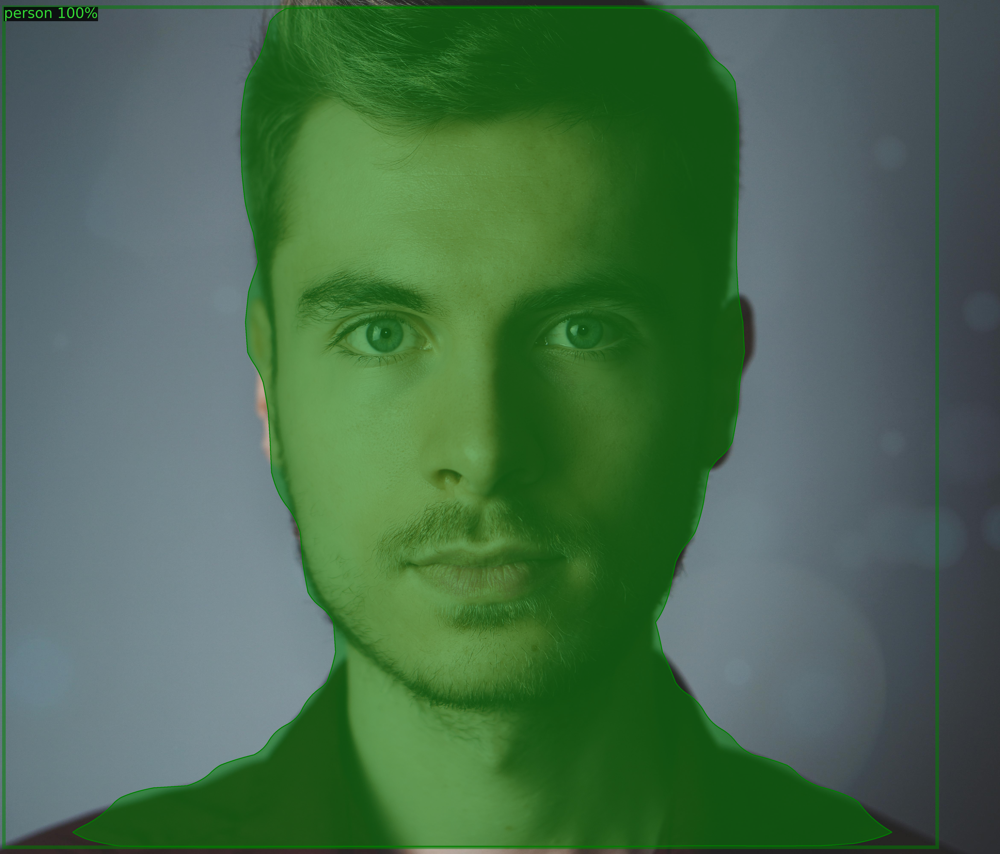


Processing image: /content/Images/Candid photography1.jpg


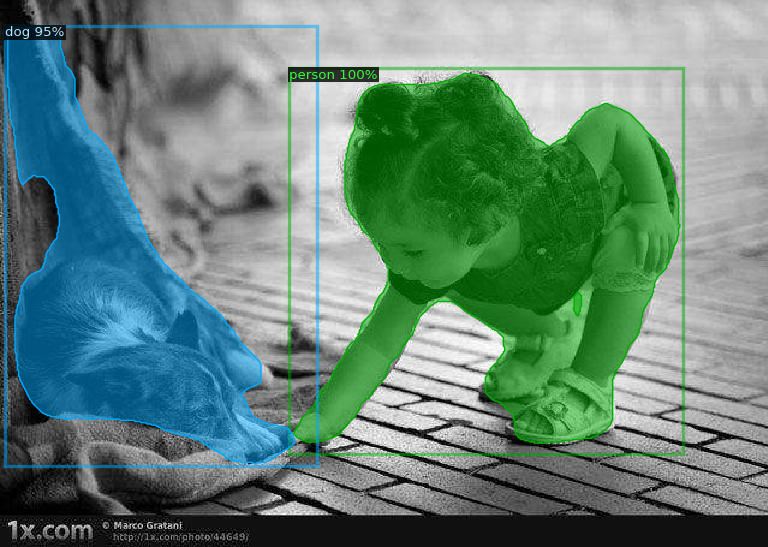


Processing image: /content/Images/Blurry faces2.jpg


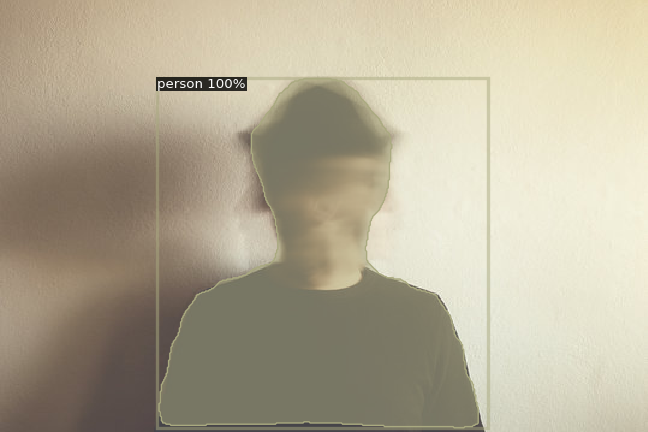


Processing image: /content/Images/Blurry faces1.jpg


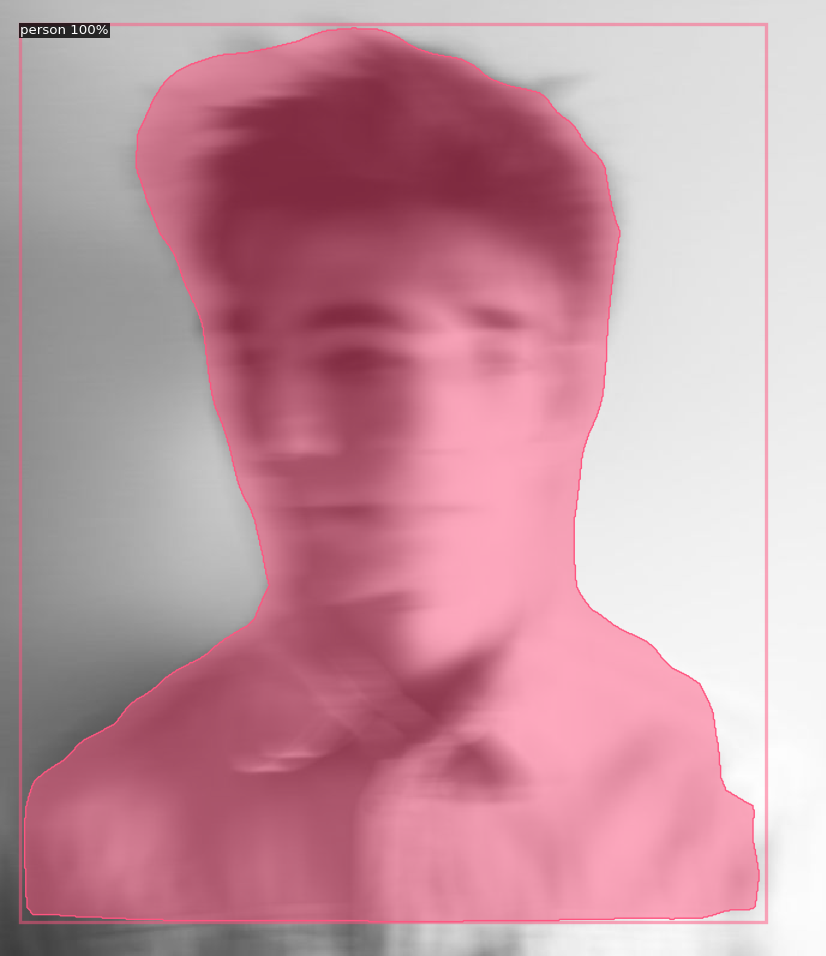


Processing image: /content/Images/Occluded faces2.jpg


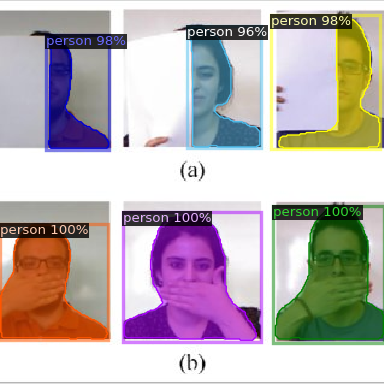


Processing image: /content/Images/Diverse demographics faces1.jpg


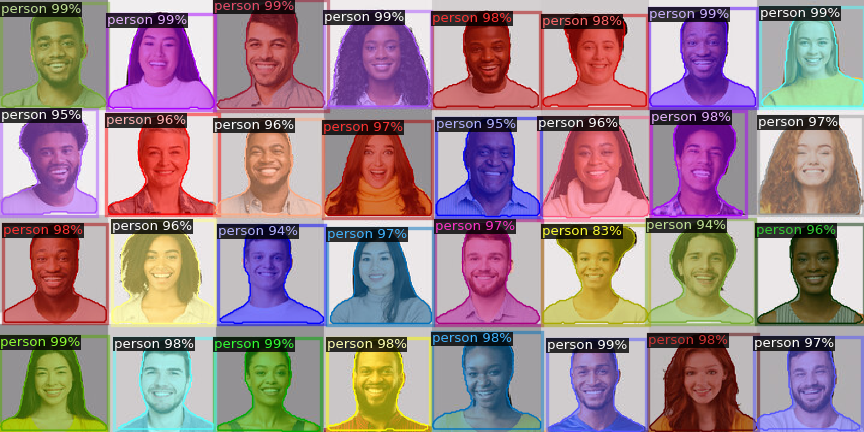


Processing image: /content/Images/Group portraits1.jpg


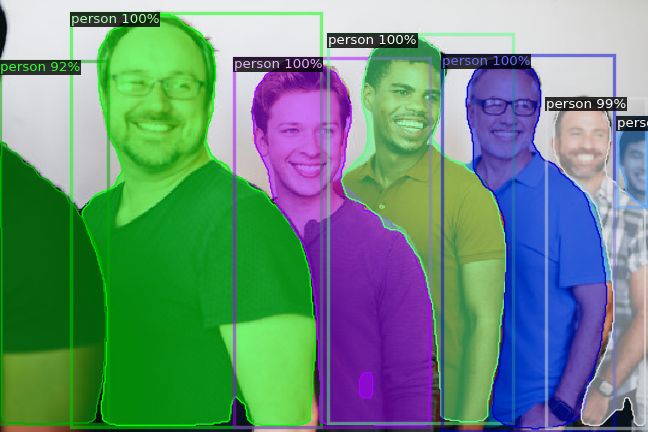


Processing image: /content/Images/Occluded faces1.png


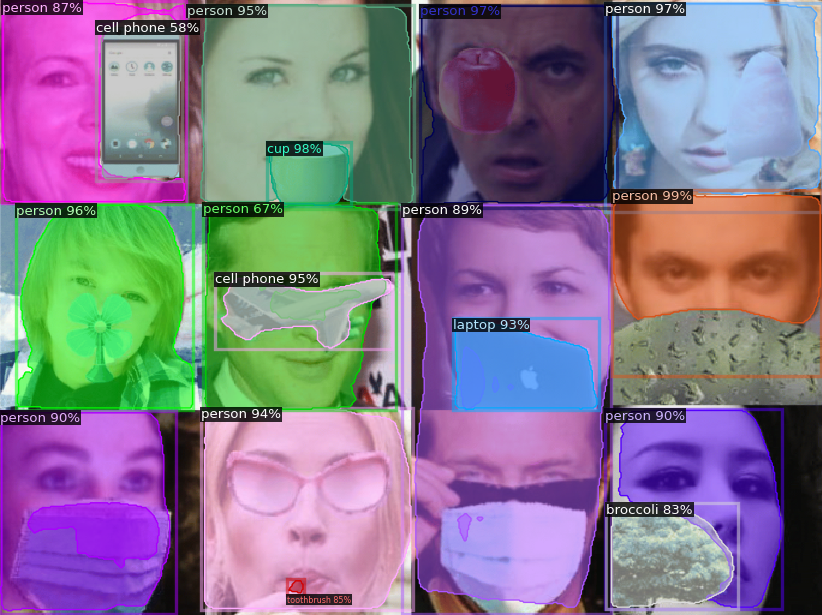


Processing image: /content/Images/Backlit faces2.jpg


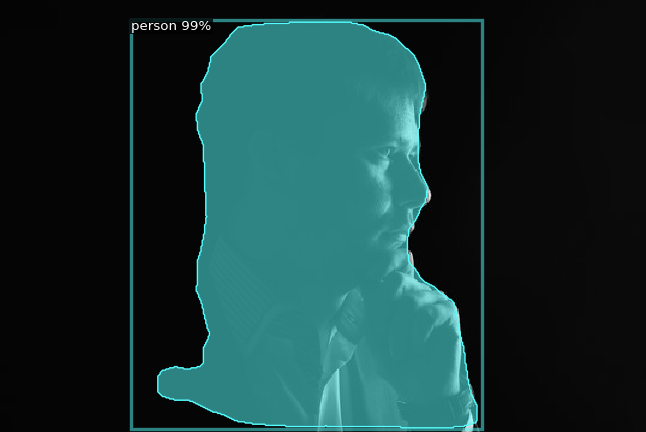


Processing image: /content/Images/Candid photography2.jpg


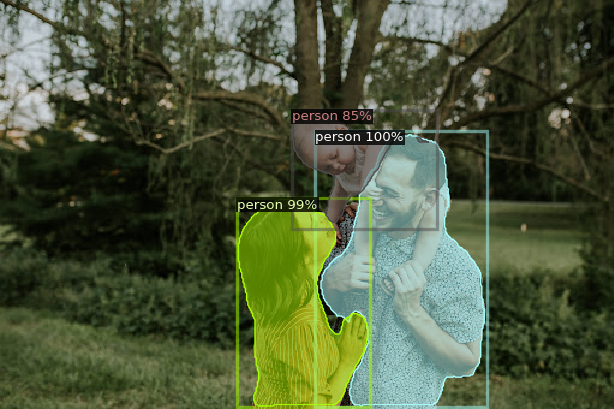

In [ ]:
from google.colab.patches import cv2_imshow

# Function to perform instance segmentation on a single image
def perform_instance_segmentation(image_path, predictor):
    im = cv2.imread(image_path)
    outputs = predictor(im)

    # Visualize the predictions
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    result_image = out.get_image()[:, :, ::-1]
    cv2_imshow(result_image)  # Display the result using cv2_imshow instead
    return result_image

# Configuration for the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")

# Create a predictor
predictor = DefaultPredictor(cfg)

# Path to the folder containing images
folder_path = "/content/Images"

# Iterate over images in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Consider only image files
        image_path = os.path.join(folder_path, filename)
        print(f"Processing image: {image_path}")
        perform_instance_segmentation(image_path, predictor)
        print()


# Run a pre-trained panoptic_fpn_R_101_3x

In [ ]:
from google.colab.patches import cv2_imshow

# Function to perform instance segmentation on a single image
def perform_instance_segmentation(image_path, predictor):
    im = cv2.imread(image_path)
    outputs = predictor(im)

    # Visualize the predictions
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    result_image = out.get_image()[:, :, ::-1]
    cv2_imshow(result_image)  # Display the result using cv2_imshow instead
    return result_image

# Configuration for the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")

# Create a predictor
predictor = DefaultPredictor(cfg)

# Path to the folder containing images
folder_path = "/content/Images"

# Iterate over images in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Consider only image files
        image_path = os.path.join(folder_path, filename)
        print(f"Processing image: {image_path}")
        perform_instance_segmentation(image_path, predictor)
        print()
